# The nanoparticle cluster status analysis based on conventional neural network

## 1. background：

Cell-membrane-camouﬂaged nanoparticles(CMC-NPs) have been increasingly exploited to develop various therapeutic tools due to their high biocompatibility and cell-type-specific tumor-targeting properties. However, the molecular mechanism of CMC-NPs for homotypic targeting remains elusive. Fan's team developed a plasmonic imaging method by coating gold nanoparticles (AuNPs) with cancer cell membranes and perform plasmonic imaging of the interactions between CMC-NPs and living cells at the single-cell level. This method is crucial in tracking the CMC-NPs because it helps people better understand the mechanism of the CMC-NPs.

However, it is difficult for people to do quantitative analysis of CMC-NPs in a different clustering status because of the following problems:

1. Due to the differences in background signals, instrument noise, and manual manipulation errors, the image will be slightly different, which made it hard to be identified by the color of the cluster manually
2. The image contains thousands of nanoparticles and impurities. It is hard to guarantee efficiency and accuracy by using manual discrimination.
3. Auxiliary methods such as spectrum or SEM can help people recognize the exact status of clusters, but these methods need complex processes and long time, which cannot be used in real-time particle tracking

Therefore, our team tries to use the machine learning method to automatically recognize the status of the particle.

![暗场显微镜纳米颗粒成像图片](./sample.jpg)
<center>
The image of darkfield microscope, which contains many nanoparticles as well as impurities
</center>

## 2. method

- step1: We gained every single particle of the image by using a segmentation algorithm.
- step2: The experimenter provided the labeled particle images (they observed the same particle by using both the darkfield microscope and SEM, which is very complex and cannot be used for instantaneous analysis)
- step3: We built the CNN  and use the dataset to train and test the network, we also use algorithms such as DeepSHAP to interpret the network to guarantee its validity.
- step4: We identified the status of the nanoparticles gained in the step1 by using the CNN network built in the step 3.

The experimental process is as follow ：

<img src="./Experiment%20Step.png" style="zoom:40%" />

## 3. Particle Segment Algorithm

### 3.1 Algorithm Introduction
   We use the algorithm proposed by Satoshi Suzuki, which extracts the contour of the image content based on the topological structure of the binary image.
### 3.2 Exclusion Conditions
 Based on the experiences of experimenters, we treated the particles as impurities or other interference factors if they match one of these conditions:

1. the area of the particle is bigger than 3000 px, or lower than 10px.
2. particles near the edge of the image

   
### 3.3 Code and experiment result


In [9]:
# Related Functions and Packages

import imutils
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image

def imshow(img):
    img = cv.cvtColor(img,cv.COLOR_BGR2RGB)
    display(Image.fromarray(img))

In [10]:
# Read sample image
img = cv.imread("sample.jpg")
gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
thresh =  cv.threshold(gray, 0, 255,cv.THRESH_BINARY | cv.THRESH_OTSU)[1]

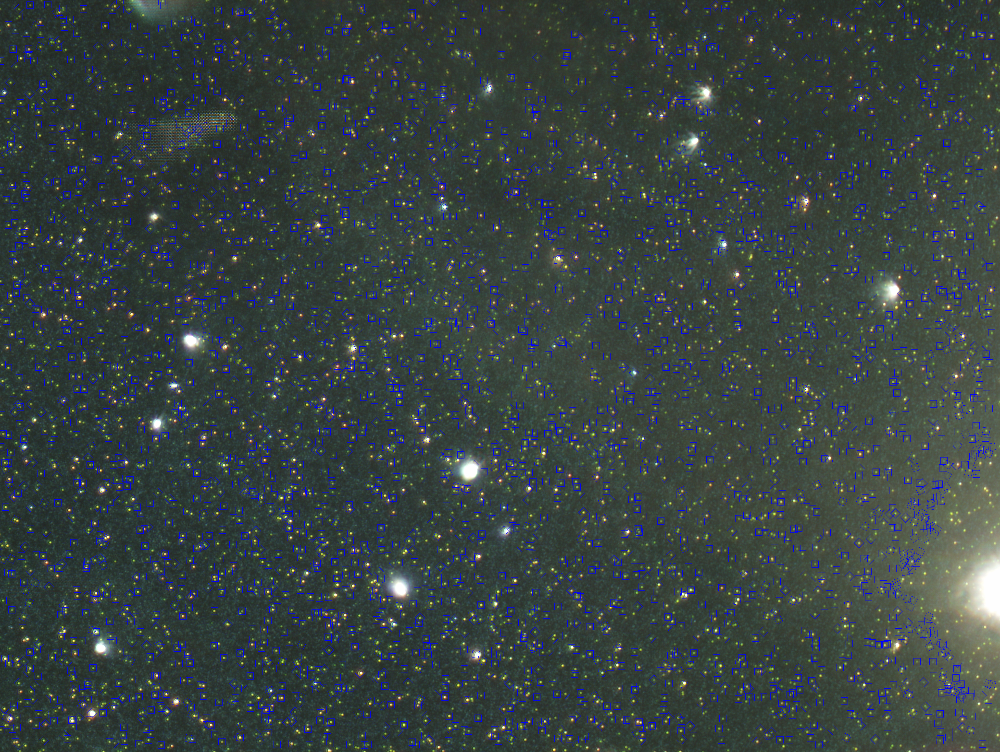

In [11]:
# Particle Segment Algorithm
unit_height = 28
unit_width = 28
count = 0

segment_detail=[]
segment_label= ["image_num","center_x","center_y","width","height","angle"]

cnts = cv.findContours(thresh.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)

img_copy = img

cnts = imutils.grab_contours(cnts)
for (i,c) in enumerate(cnts):
    rect = cv.minAreaRect(c)
    ((x,y),(width,height),angle) = rect

    # exclusion condition1: particle area less than 3000 px and bigger than 10 px
    area = width * height
    if area>3000 or area<10:
        continue


    # exclusion condition2: points near image edges
    img_height, img_width,pix_value = img.shape
    if  x+unit_width>img_width or y+unit_height>img_height:
        continue

#     # exclusion condition3: the blue channel of the particle is 2 times less than other channels
#     unit = cv.getRectSubPix(img,(unit_width,unit_height),(x,y))
#     b,g,r=cv.split(unit)
#     total_b = sum(sum(b))
#     total_g = sum(sum(g))
#     total_r = sum(sum(r))
#     if  total_b>= 2*total_g or total_b>=2*total_r:
#         continue

    segment_detail.append([count,x,y,unit_width,unit_height,angle])
    # draw box in the copy of the image
    box = cv.boxPoints(((x,y),(unit_width,unit_height),angle))
    box = np.int0(box)
    cv.drawContours(img_copy,[box],0,(255,0,0),1)
    # save the segmented image
    path = "./seg_result/"+str(count)+".jpg"
    cv.imwrite(path,unit)
    count = count + 1

import pandas as pd
res = pd.DataFrame(columns=segment_label,data=segment_detail)
res.to_csv("./seg_info.csv")
imshow(img_copy)

In [13]:
# particle segment finished
%reset
# this command will delete all variables to avoid interfere other cells

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


## 4. CNN network construction and training


### 4.1 the CNN network structure of the experiment
   The experiment use the Pytorch to build a LeNet5 network to identify the status of particles.
   

   <img src="network_structure.png" style="zoom:40%" />
   <center>the structure of the CNN</center>


   - Input： 32x32 three channel image (the labeled image)
   - Dataset：
       - The dataset contains 100 pics of segmented nanoparticle image. 38 of these pics are segmented clusters, and the other 62 pics are single particle.
       - The experiment randomly divided the labeled dataset into two parts, a training set(80%) and a validation set(20%) since the labeled data set is balance.
       
   - Result：
       - accuracy：90%
       - confusion matrix：{'TP': 4, 'FP': 1, 'FN': 1, 'TN': 14}
       

In [45]:
# import package and read labeled dataset
import os
import pandas
from PIL import Image
import torch.utils.data

class MedicPicDataset(torch.utils.data.Dataset):
    def __init__(self, root,transforms=None):
        self.root = root
        # load all image files, sorting them to ensure that they are aligned
        self.imgs = list(sorted(os.listdir(os.path.join(root,"MedImgs"))))
        self.transforms = transforms

    def __getitem__(self, item):

        # read imgs
        item=item+1
        img_name = "1-"+str(item) +".tif"
        img_path = os.path.join(self.root,"MedImgs",img_name)
        item_data = Image.open(img_path)

        # transform data
        if self.transforms:
            item_data = self.transforms(item_data)

        # read label of the dataset
        label_file_path = os.path.join(self.root,"label.xlsx")
        label_data = pandas.read_excel(label_file_path)
        item_label = label_data.iloc[item-1,2]
        return item_data, item_label

    def __len__(self):
        return len(self.imgs)

# construct training dataset and test dataset
# the labeled dataset has 100 images, which contains 38 congeries(label=1) and 62 non-congeries(label=0)

from torchvision import transforms as T
transforms = T.Compose([
    T.Resize(32),
    T.ToTensor(),
    T.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))

])

TRAIN_RATE = 0.8    # 80% of the data are training dataset
VALIDATE_RATE = 0
dataset = MedicPicDataset(root="./",transforms=transforms)

dataset_len = dataset.__len__()
temp = list(range(dataset_len))
train_size = int(dataset_len * TRAIN_RATE)
validate_size = int(dataset_len * VALIDATE_RATE)
test_size = dataset_len - train_size - validate_size

from torch.utils.data import DataLoader
train_dataset, validate_dataset, test_dataset = torch.utils.data.random_split(dataset,[train_size,validate_size,test_size])


train_loader = DataLoader(train_dataset, batch_size=1, shuffle=False,num_workers=0)
validate_loader = DataLoader(validate_dataset, batch_size=1, shuffle=False,num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False,num_workers=0)

In [46]:
# construct CNN network

import torch
from torch import nn
import torch.nn.functional as F


def num_flat_feature(x):
    size = x.size()[1:]
    num_feature = 1
    for s in size:
        num_feature *= s
    return num_feature


class Net(nn.Module):
    def __init__(self):
        super(Net,self).__init__()

        self.conv1 = nn.Conv2d(3, 6, 5)  # three channels, six conventional kernel, the kernel size is 5x5
        self.conv2 = nn.Conv2d(6, 16, 5)

        self.fc1 = nn.Linear(16*5*5,120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 2)

    def forward(self,x):
        x = F.max_pool2d(F.relu(self.conv1(x)),(2,2))
        x = F.max_pool2d(F.relu(self.conv2(x)),2)
        x = x.view(-1, 16*5*5)      #
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

    def num_flat_features(self,x):
        size = x.size()[1:]
        num_feature = 1
        for s in size:
            num_feature *= s
        return num_feature

net= Net()
print(net)  ## print the structure of the CNN network

# loss function and optimizer
import torch.optim as optim
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

Net(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (fc1): Linear(in_features=400, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=2, bias=True)
)


In [47]:
# training the CNN network

EPOCH = 50
for epoch in range(EPOCH):
    running_loss = 0.0
    for i, data in enumerate(train_loader,0):
        inputs, labels = data
        optimizer.zero_grad()
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

In [48]:
# use the test dataset to check the performance of the trained CNN model
correct = 0
total = 0

confusion_matrix={
    "TP":0,
    "FP":0,
    "FN":0,
    "TN":0,
}



def confusion_calculate(output, label,confusion_matrix):
    if  label == output:
        if label == 1:
            confusion_matrix["TP"] += 1
        else:
            confusion_matrix["TN"] += 1
    else:
        if label == 1:
            confusion_matrix["FP"] += 1
        else:
            confusion_matrix["FN"] += 1


roc_score = list()
roc_label = list()

with torch.no_grad():
    TP,FP,FN,TN=0,0,0,0
    for data in test_loader:
        images, labels = data
        outputs = net(images)
        _,predicted = torch.max(outputs.data ,1)

        roc_label.append(labels)
        roc_score.append(predicted)
        confusion_calculate(output=predicted, label=labels,confusion_matrix=confusion_matrix)
        total = total + 1
        if predicted == labels:
            correct = correct + 1

print(correct/total)
print(confusion_matrix)

0.9
{'TP': 4, 'FP': 1, 'FN': 1, 'TN': 14}


In [19]:
# save the model and delete all local variables
torch.save(net,"cnn.pth")

In [32]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


## 5. CNN  interpret

### 5.1 the introduction of the CNN network interpret
  Recently, people pay attention to the interpretability of the machine learning model. We hope to understand which part of the image is important for the model. Therefore, we use the DeepSHAP algorithm to explain the model and the result shows that the model matches the experimenter's experience.

### 5.2 Code and experiment result

In [57]:
# import packages to interpret the CNN model

from captum.attr import IntegratedGradients
from captum.attr import Saliency
from captum.attr import InputXGradient
from captum.attr._core.guided_backprop_deconvnet import GuidedBackprop
from captum.attr._core.guided_grad_cam import GuidedGradCam
from captum.attr import DeepLift
from captum.attr import NoiseTunnel
from captum.attr import DeepLiftShap
from captum.attr import visualization as viz
import numpy as np
import matplotlib.pyplot as plt



In [52]:
ind = 0
device = torch.device("cpu")
dataiter = iter(test_loader)
images, labels = dataiter.__next__()
images = images.to(device)

original_image = np.transpose((images[ind].cpu().detach().numpy() / 2) + 0.5, (1, 2, 0))




In [53]:
# A generic function that will be used for calling `attribute` on attribution algorithm defined in input.

def attribute_image_features(algorithm, input, **kwargs):
    net.zero_grad()
    tensor_attributions = algorithm.attribute(input,
                                              target=predicted[ind],
                                              **kwargs
                                             )

    return tensor_attributions

# functions for distribution
def get_distribution_dataindex(root, label):
        label_file_path = os.path.join(root,"label.xlsx")
        label_data = pandas.read_excel(label_file_path)
        return label_data[label_data["output"]==label].index

def generate_distribution_data(index,length,reference_np,dataset):
    index = index.to_list()
    import random
    random.shuffle(index)
    for sample in range(length):
        reference_np[sample],label = dataset.__getitem__(index[sample])
    return torch.from_numpy(reference_np)

def plot_reference_data(background,name):
    background = background.numpy()
    background = np.mean(background,axis=0)
    background = np.transpose(background,(1, 2, 0))
    # background = np.repeat(background,3,axis=-1)/255
    fig,axis = viz.visualize_image_attr(None, background,
                          method="original_image", title=name)
    fig.savefig("figures/"+name)
    return background


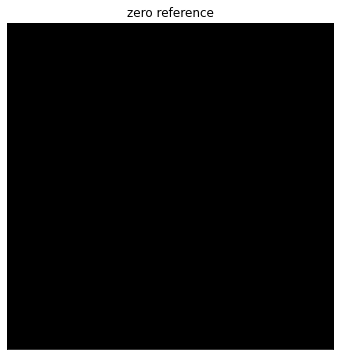

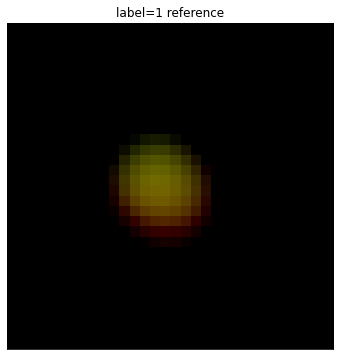

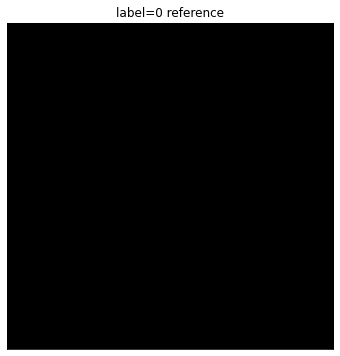

In [70]:
# generate references based on the dataset

sample_number = 20
zero_label_reference = torch.zeros((sample_number,3,32,32))
zero_background = plot_reference_data(zero_label_reference,"zero reference")


label_reference_np = np.empty((sample_number,3,32,32), dtype = float, order = 'C')
label_index =  get_distribution_dataindex("./",1)
label1_reference_np = generate_distribution_data(label_index,sample_number,label_reference_np,dataset)

label1_background = plot_reference_data(torch.from_numpy(label_reference_np),"label=1 reference")


label_reference_np = np.empty((sample_number,3,32,32), dtype = float, order = 'C')
label_index =  get_distribution_dataindex("./",0)
label0_reference_np = generate_distribution_data(label_index,sample_number,label_reference_np,dataset)
label0_background = plot_reference_data(torch.from_numpy(label_reference_np),"label=0 reference")

In [71]:
order = 0

input= images[ind].unsqueeze(0)
saliency = Saliency(net)
grads = saliency.attribute(input, target=labels[order].item(), abs=False)
grads = np.transpose(grads.squeeze(axis=0).cpu().detach().numpy(), (1, 2, 0))

# DeepLift
dl = DeepLift(net)
attr_dl = attribute_image_features(dl, input, baselines=input * 0)
attr_dl = np.transpose(attr_dl.squeeze(0).cpu().detach().numpy(), (1, 2, 0))

# DeepLiftShap

# reference distribution:
## zero  reference
ds = DeepLiftShap(net)
attr_ds = attribute_image_features(ds, input, baselines=zero_label_reference.view(-1,3,32,32).float())
attr_ds = np.transpose(attr_ds.squeeze(0).cpu().detach().numpy(), (1, 2, 0))


## label=1 reference
attr_ds_1 = attribute_image_features(ds, input, baselines=label1_reference_np.view(-1,3,32,32).float())
attr_ds_1 = np.transpose(attr_ds_1.squeeze(0).cpu().detach().numpy(), (1, 2, 0))

## label=0 reference

attr_ds_0 = attribute_image_features(ds, input, baselines=label0_reference_np.view(-1,3,32,32).float())
attr_ds_0 = np.transpose(attr_ds_0.squeeze(0).cpu().detach().numpy(), (1, 2, 0))


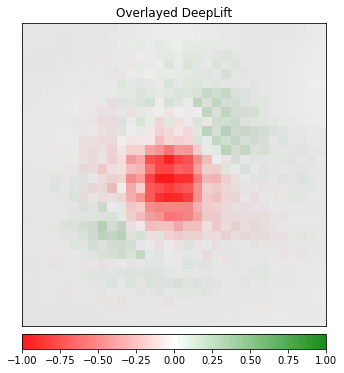

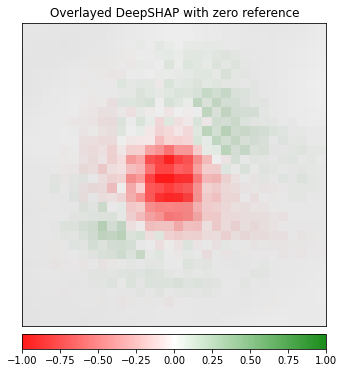

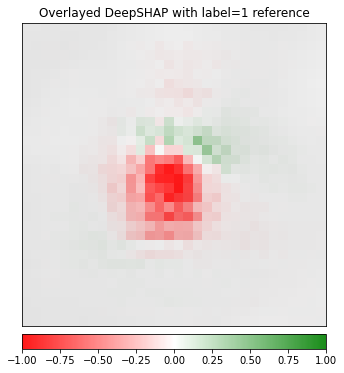

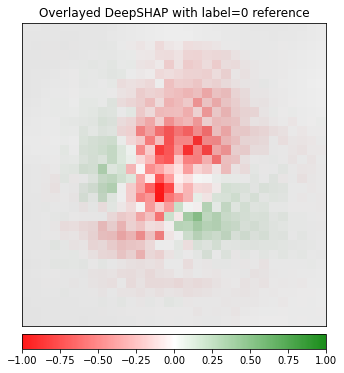

In [68]:
# draw 

# deeplift
fig,axis = viz.visualize_image_attr(attr_dl/attr_dl.max(), original_image, method="blended_heat_map",sign="all",show_colorbar=True,
                              title="Overlayed DeepLift",alpha_overlay=0.9)
fig.savefig('figures/deeplift.png')
plt.close()

# deepshap with zero reference
fig,axis = viz.visualize_image_attr(attr_ds, original_image, method="blended_heat_map",sign="all",show_colorbar=True,
                          title="Overlayed DeepSHAP with zero reference",alpha_overlay=0.9)
fig.savefig('figures/deepshap with zero ref.png')
plt.close()


# deepshap with label=1 reference
fig,axis = viz.visualize_image_attr(attr_ds_1, original_image, method="blended_heat_map",sign="all",show_colorbar=True,
                          title="Overlayed DeepSHAP with label=1 reference",alpha_overlay=0.9)
fig.savefig('figures/deepshap with label1 ref.png')
plt.close()

# deepshap with label=0 reference
fig,axis = viz.visualize_image_attr(attr_ds_0, original_image, method="blended_heat_map",sign="all",show_colorbar=True,
                          title="Overlayed DeepSHAP with label=0 reference",alpha_overlay=0.9)
fig.savefig('figures/deepshap with label0 ref')
plt.close()

## 6. Use the trained CNN network to analyze the nano particle

In [21]:
# construct the CNN network structure and import parameters
import os
from PIL import Image
import torch.utils.data
import torch
from torch import nn
import torch.nn.functional as F
import pandas as pd

class Net(nn.Module):
    def __init__(self):
        super(Net,self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16*5*5,120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 2)

    def forward(self,x):
        x = F.max_pool2d(F.relu(self.conv1(x)),(2,2))
        x = F.max_pool2d(F.relu(self.conv2(x)),2)
        x = x.view(-1, 16*5*5)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

    def num_flat_features(self,x):
        size = x.size()[1:]
        num_feature = 1
        for s in size:
            num_feature *= s
        return num_feature

net = torch.load("cnn.pth")
net.eval()

import torch.optim as optim
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

# import segmented images
class SegResultDataset(torch.utils.data.Dataset):
    def __init__(self,root,transforms=None):
        self.root = root
        self.imgs = list(sorted(os.listdir(os.path.join(root,"seg_result"))))
        self.transforms = transforms

    def __getitem__(self, item):

        # read imgs
        img_name = str(item)+".jpg"
        img_path = os.path.join(self.root,"seg_result",img_name)
        item_data = Image.open(img_path)

        # transform data
        if self.transforms:
            item_data = self.transforms(item_data)
        return item_data,item

    def __len__(self):
        return len(self.imgs)-1

from torchvision import transforms as T
transforms = T.Compose([
    T.Resize(32),
    T.ToTensor(),
    T.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

dataset = SegResultDataset(root="./",transforms=transforms)

from torch.utils.data import Dataset, DataLoader
sample_dataloader = DataLoader(dataset,batch_size=1,shuffle=False,num_workers=0)

In [22]:
# use the trained CNN model to classify the segmented images
import cv2 as cv
import numpy as np
dac_arr = []

img = cv.imread("sample.jpg")
csv_data = pd.read_csv("./seg_info.csv",low_memory=False)
segment_detail = pd.DataFrame(csv_data)

def save_and_show(pic_num,pic_result):
    _,seg_num,center_x,center_y,width,height,angle = segment_detail.iloc[pic_num]
    if  seg_num != pic_num:
        print("wrong!!")
        return
    box = cv.boxPoints(((center_x,center_y),(width,height),angle))
    box = np.int0(box)
    if pic_result == 0:
        cv.drawContours(img,[box],0,(255,0,0),1)
        cv.putText(img,"#{}".format(pic_num),(int(center_x+10),int(center_y)),cv.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
    else:
        cv.drawContours(img,[box],0,(0,0,255),1)
        cv.putText(img,"#{}".format(pic_num),(int(center_x+10),int(center_y)),cv.FONT_HERSHEY_SIMPLEX, 0.6, (0, 0, 255), 2)


with torch.no_grad():
    for data in sample_dataloader:
        image,num = data
        output = net(image)
        _,predicted = torch.max(output.data,1)
        save_and_show(int(num[0]),int(predicted[0]))
        # temp = [str(int(num[0])),str(int(predicted[0]))]
        # dac_arr.append(temp)
        # break

# label=["image_num","result"]
# import pandas as pd
# res = pd.DataFrame(columns=label,data=dac_arr)
# res.to_csv("./res.csv")

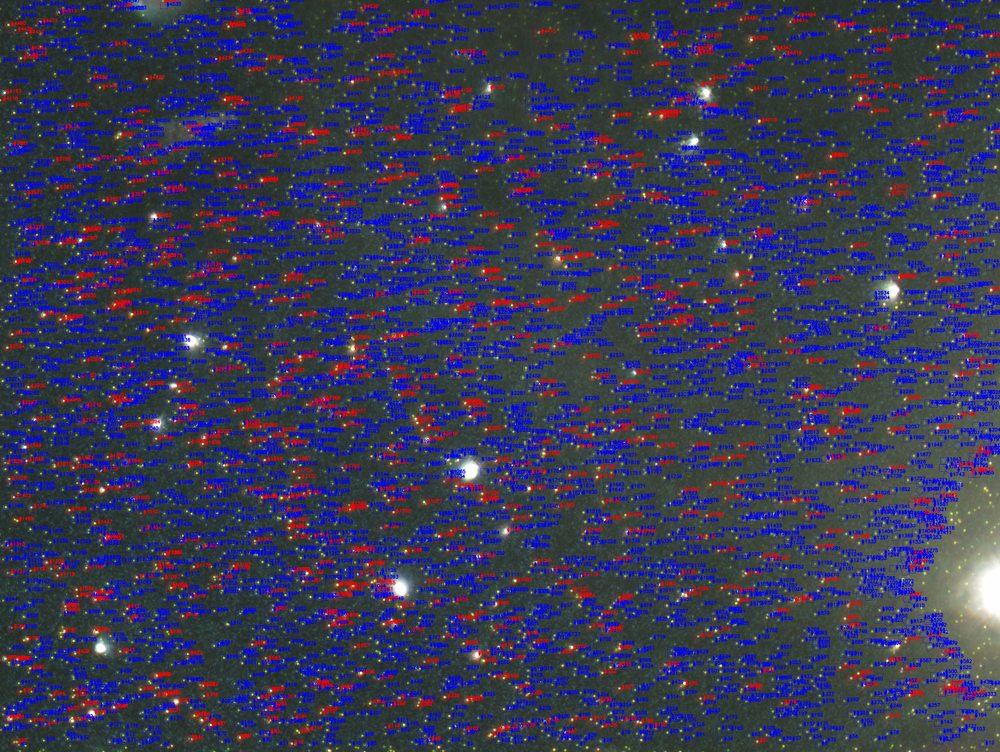

In [24]:
def imshow(img):
    img = cv.cvtColor(img,cv.COLOR_BGR2RGB)
    display(Image.fromarray(img))

imshow(img)